In [2]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import contextily as cx
import hamhelper.colours as hc
import hamhelper.plotting as hp
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize


In [3]:
# import data
data_file = r'data\indicator-data.csv'
df = pd.read_csv(data_file, delimiter=';').iloc[1: , :]  # drop first row of all NaNs for pre 2010 private entries

selection = ['Residents who meet the Canadian Physical Activity Guidelines']
selected_data = df[df['IndicatorName'].isin(selection)]
selected_data.head()

,IndicatorId,IndicatorName,Granularity,PeriodLabel,PeriodEnd,ActualValue,ActualValueText,ForecastValue,TargetValue,TargetValueText,Notes,GeoLevelName,DisaggregationCategory,GeographyId,Dimension,DimensionId,GeographyName,Geom,geo_point_2d
293,435,Residents who meet the Canadian Physical Activ...,Annual,2014,2014-12-31,46.0,46%,NaN,NaN,NaN,NaN,HSDA,All,22.0,NaN,NaN,HSDA,"{""coordinates"": [[[[-123.023085, 49.293495], [...","49.24972334139539, -123.12267513252552"
370,435,Residents who meet the Canadian Physical Activ...,Annual,2025,2025-12-31,NaN,NaN,NaN,NaN,Up 25%,NaN,HSDA,All,22.0,NaN,NaN,HSDA,"{""coordinates"": [[[[-123.023085, 49.293495], [...","49.24972334139539, -123.12267513252552"
509,435,Residents who meet the Canadian Physical Activ...,Annual,2014,2014-12-31,35.0,35%,NaN,NaN,NaN,NaN,Local Area MHMC,All,17.0,NaN,NaN,Killarney,"{""coordinates"": [[[[-123.039271, 49.204637], [...","49.21759183276995, -123.03759581452424"
510,435,Residents who meet the Canadian Physical Activ...,Annual,2014,2014-12-31,39.0,39%,NaN,NaN,NaN,NaN,Local Area MHMC,All,7.0,NaN,NaN,UBC,"{""coordinates"": [[[-123.196481, 49.253934], [-...","49.2577770144466, -123.23023538914651"
511,435,Residents who meet the Canadian Physical Activ...,Annual,2014,2014-12-31,47.0,47%,NaN,NaN,NaN,NaN,Local Area MHMC,All,15.0,NaN,NaN,Shaughnessy/Arbutus-Ridge/Kerrisdale,"{""coordinates"": [[[[-123.177188, 49.216385], [...","49.236569876799685, -123.15394869124897"


In [4]:
geom = selected_data.loc[:, 'Geom'] # .to_numpy()

geom.head()

293    {"coordinates": [[[[-123.023085, 49.293495], [...
370    {"coordinates": [[[[-123.023085, 49.293495], [...
509    {"coordinates": [[[[-123.039271, 49.204637], [...
510    {"coordinates": [[[-123.196481, 49.253934], [-...
511    {"coordinates": [[[[-123.177188, 49.216385], [...
Name: Geom, dtype: object

In [5]:
import geojson # or import geojson
with open(r"data\indicator-data.geojson") as json_file:
    json_data = geojson.load(json_file) # or geojson.load(json_file)

In [6]:
keys = json_data.keys()

display(json_data)

{"features": [{"geometry": null, "properties": {"actualvalue": 12.1, "actualvaluetext": "12.1", "dimension": null, "dimensionid": null, "disaggregationcategory": "All", "forecastvalue": null, "geo_point_2d": null, "geographyid": null, "geographyname": null, "geolevelname": null, "geom": null, "granularity": "Quarterly", "indicatorid": 53, "indicatorname": "Time to process an affordable housing development permit application", "notes": null, "periodend": "2018-12-31", "periodlabel": "Q4 2018", "targetvalue": 12.0, "targetvaluetext": "12.0"}, "type": "Feature"}, {"geometry": null, "properties": {"actualvalue": 89.1, "actualvaluetext": "89.1%", "dimension": null, "dimensionid": null, "disaggregationcategory": "All", "forecastvalue": null, "geo_point_2d": null, "geographyid": null, "geographyname": null, "geolevelname": null, "geom": null, "granularity": "Quarterly", "indicatorid": 55, "indicatorname": "Construction and trades inspections that are done on time", "notes": null, "periodend":

In [7]:
import geopandas as gpd
df_geo = gpd.read_file(r"data\indicator-data.geojson")
print(df_geo.columns)

df_geo.head()

Index(['indicatorid', 'indicatorname', 'granularity', 'periodlabel',
       'periodend', 'actualvalue', 'actualvaluetext', 'forecastvalue',
       'targetvalue', 'targetvaluetext', 'notes', 'geolevelname',
       'disaggregationcategory', 'geographyid', 'dimension', 'dimensionid',
       'geographyname', 'geom', 'geo_point_2d', 'geometry'],
      dtype='object')


,indicatorid,indicatorname,granularity,periodlabel,periodend,actualvalue,actualvaluetext,forecastvalue,targetvalue,targetvaluetext,notes,geolevelname,disaggregationcategory,geographyid,dimension,dimensionid,geographyname,geom,geo_point_2d,geometry
0,53,Time to process an affordable housing developm...,Quarterly,Q4 2018,2018-12-31,12.1,12.1,None,12.0,12.0,None,None,All,NaN,None,None,None,None,None,None
1,55,Construction and trades inspections that are d...,Quarterly,Q4 2017,2017-12-31,89.1,89.1%,None,93.0,93.0%,None,None,All,NaN,None,None,None,None,None,None
2,55,Construction and trades inspections that are d...,Quarterly,Q1 2018,2018-03-31,88.5,88.5%,None,93.0,93.0%,None,None,All,NaN,None,None,None,None,None,None
3,56,Time to process a minor commercial renovation ...,Quarterly,Q1 2018,2018-03-31,6.4,6.4,None,5.0,5.0,None,None,All,NaN,None,None,None,None,None,None
4,56,Time to process a minor commercial renovation ...,Quarterly,Q2 2018,2018-06-30,5.9,5.9,None,5.0,5.0,None,None,All,NaN,None,None,None,None,None,None


In [8]:
# Select data
selection_type = ['Residents who meet the Canadian Physical Activity Guidelines']
selection_year = ['2014']
selection_survey = ['Local Area MHMC']

selected_data = df_geo[df_geo['indicatorname'].isin(selection)]
selected_data = selected_data[selected_data['periodlabel'].isin(selection_year)]
selected_data = selected_data[selected_data['geolevelname'].isin(selection_survey)]

geom = selected_data.loc[:, 'geometry'].to_numpy()
val = selected_data.loc[:, 'actualvalue'].to_numpy()
geoName = selected_data.loc[:, 'geographyname'].to_numpy()

geoGeom = gpd.GeoSeries(geom)
colors = hc.HamColour.from_name('ptol_sunset')


ii [0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ] 11


None
[-123.311144, 49.159719, -122.958937, 49.31535]
Killarney                              -> <class 'shapely.geometry.multipolygon.MultiPolygon'>  = 35.0%
UBC                                    -> <class 'shapely.geometry.polygon.Polygon'>            = 39.0%
Shaughnessy/Arbutus-Ridge/Kerrisdale   -> <class 'shapely.geometry.multipolygon.MultiPolygon'>  = 47.0%
Kitsilano                              -> <class 'shapely.geometry.polygon.Polygon'>            = 58.0%
Renfrew-Collingwood                    -> <class 'shapely.geometry.polygon.Polygon'>            = 36.0%
Grandview-Woodland                     -> <class 'shapely.geometry.polygon.Polygon'>            = 45.0%
Mount Pleasant                         -> <class 'shapely.geometry.polygon.Polygon'>            = 52.0%
Sunset                                 -> <class 'shapely.geometry.polygon.Polygon'>            = 41.0%
South Cambie/Oakridge                  -> <class 'shapely.geometry.polygon.Polygon'>            = 38.0%
Hastings-Su

Text(0.5, 1.0, 'Quality: Residents who meet the Canadian Physical Activity Guidelines | Year: 2014 | Survey: Local Area MHMC\n')

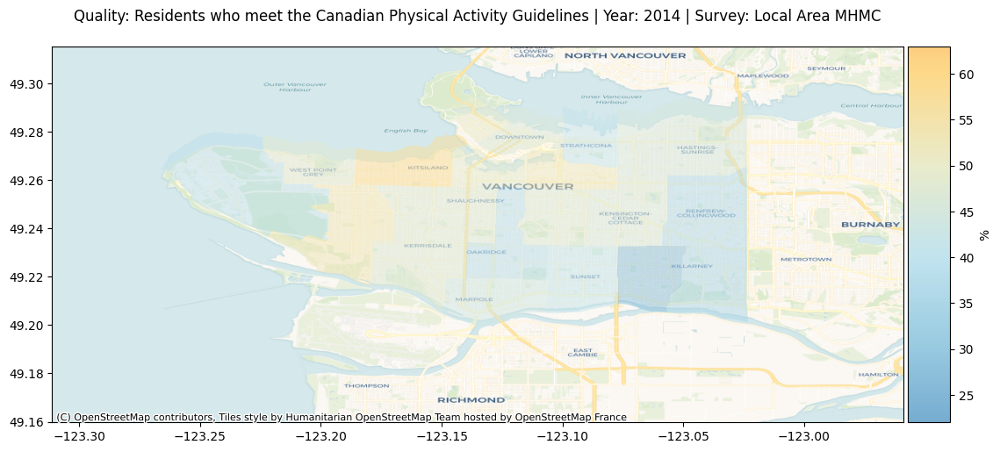

In [94]:

fig, ax = plt.subplots(1, 1, figsize = np.array([3.3, 2.2])*4)

print(geoGeom.crs)

# make map
extent = geoGeom.geometry.total_bounds
west, south, east, north = extent
van_img, van_ext = cx.bounds2img(west, south, east, north, ll=True, source=cx.providers.CartoDB.Voyager)

west += -0.045
east += 0.064
north += 0.02
south += -0.04
print([west, south, east, north])
bbox = np.array([west, east, south, north])  # + np.array([-0.03, 0, 0, -0.005])
ax.imshow(van_img, zorder=1, extent=bbox)
# plt.show()

# fig, ax = plt.subplots(1, 1, figsize = np.array([3.3, 2.2])*4)

cx.add_basemap(ax, crs=geoGeom.crs, zoom = 0)

totSize = val.size
hasGeom = np.zeros(val.shape)
for i, (g, v) in enumerate(zip(geom[::],val[::])):
    if type(g) != type(None):
        hasGeom[i] = 1
        print(f'{geoName[i]:<38} -> {str(type(g)):<53} = {v}%')
        gpd.GeoSeries(g).plot(ax = ax, color = colors(v/100), zorder = 2, alpha = 0.5)

from mpl_toolkits.axes_grid1 import make_axes_locatable

val_limits = np.array([np.min(val), np.max(val)]) + np.array([-5, 5])
cmappable = ScalarMappable(norm=Normalize(*val_limits), cmap=colors.truncate(val_limits[0]/100, val_limits[1]/100, update=False).cmap)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(cmappable, cax=cax, label = '%')
# ax.set_aspect('equal')

print('\nFILTERED TO:')
print(Q:=f"Quality: {selection_type[0]}")
print(Y:=f"Year: {selection_year[0]}")
print(S:=f"Survey: {selection_survey[0]}\n")
print(f'{np.sum(hasGeom):} out of {totSize} have a shape object!')

# hp.despine(left=False, bottom=False, axis=ax)
# ax.set(xticks=[], yticks=[])
ax.set(xlim = [west, east], ylim = [south, north])
ax.set_title(' | '.join([Q, Y, S]))

[[], []]

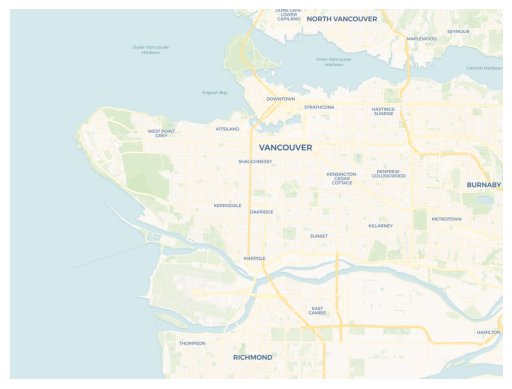

In [34]:
# Try to get the map
# vancouver = cx.Place("Vancouver")
extent = np.genfromtxt(r'data/extent.csv', delimiter = ',')
west, east, south, north = extent
ghent_img, ghent_ext = cx.bounds2img(west, south, east, north,
                                     ll=True, source=cx.providers.CartoDB.Voyager)
ghent_img.shape


fig, ax = plt.subplots()
hp.despine(left=False, bottom=False, axis=ax)
ax.set(xticks=[], yticks=[])